<a href="https://colab.research.google.com/github/clarissestoica/dog-vision/blob/master/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
#!unzip "drive/My Drive/Dog Vision/dog-breed-identification.zip" -d "drive/My Drive/Dog Vision"

# Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub. This notebook was created with guidance of a udemy course.

## 1. Problem
This project's problem is to identify the breed of any dog given an image.

## 2. Data
The data we're using is from Kaggle's dog breed identification competition.
https://www.kaggle.com/c/dog-breed-identification/data


## 3. Evaluation

According to kaggle, the evaluation is a file should contain the probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation


## 4. Features

Data Information
* The data used in this project are images, which are unstructured data. We can then use deep learning / transfer learning.
* The dataset contains 120 breeds of dogs - thus 120 unique classes.
* The training set contains over 10,000 images with labels.
* The test set also contains over 10,000 images without labels.

# Workspace
To use deep learning / transfer learning, we need TensorFlow:
1.  Import TensorFlow 2.x
2. Import TensorFlow Hub
3.  Ensure we're using a GPU

In [3]:
#1 Import Tensorflow into collab
import tensorflow as tf 
#2 Import necessary tools
import tensorflow_hub as hub
print('TF version:', tf.__version__)
print('TF Hub version:', hub.__version__)

# Check for GPU availability
print('GPU', 'available' if tf.config.list_physical_devices('GPU') else 'not available')

TF version: 2.3.0
TF Hub version: 0.9.0
GPU available


## Getting our data ready (turning into Tensors)

With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors (numerical representation)

Let's start by accessing our data and checking our labels.

In [4]:
# Check out the labels of our data
import pandas as pd
labels_csv = pd.read_csv('drive/My Drive/Dog Vision/labels.csv')
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     d34ca643d6c19c9943b40af456e62cd3  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [5]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


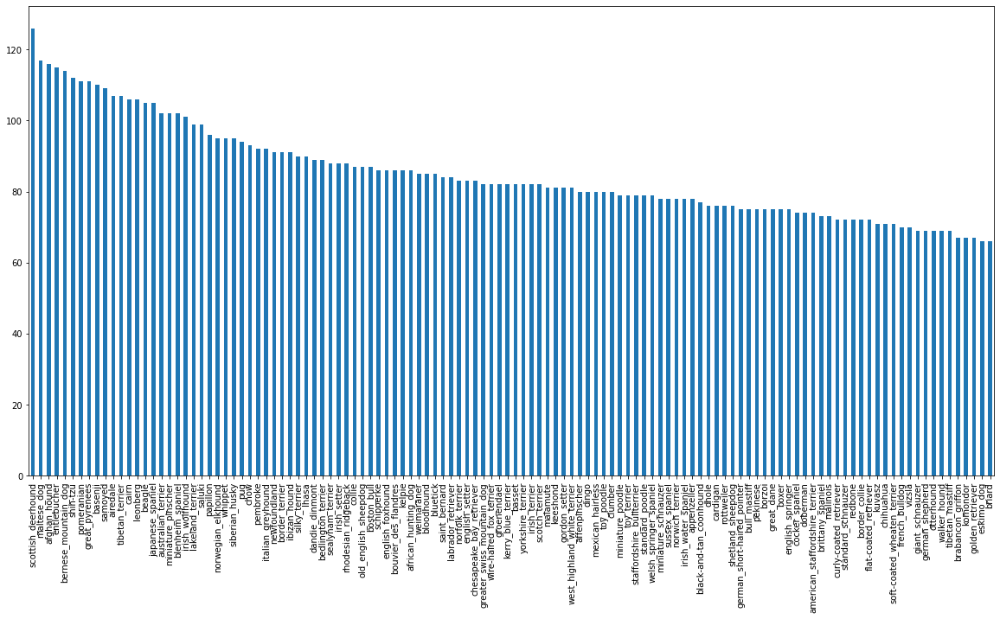

In [6]:
# How many images are there of each breeds?

labels_csv.breed.value_counts().plot(kind = 'bar',
                                     figsize = (20,10))

In [7]:
labels_csv.breed.value_counts().median()

82.0

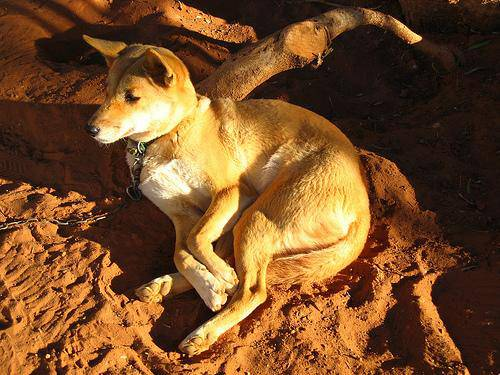

In [8]:
# Let's view an image

from IPython.display import Image
Image('drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg')

### Getting images and their labels

Let's get a list of all of our image ID's

In [9]:
# Create pathnames from image ids

filenames = ['drive/My Drive/Dog Vision/train/' + fname + '.jpg' for fname in labels_csv.id]
filenames[:5]

['drive/My Drive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [10]:
# Check whether number of filenames matches number of actual image files

import os
if len(os.listdir('drive/My Drive/Dog Vision/train')) == len(filenames):
  print('Filenames match actual amount of files. Proceed.')
else:
  print('Filenames do not maftch actual amount of files, check the target directory')

Filenames match actual amount of files. Proceed.


In [11]:
import os


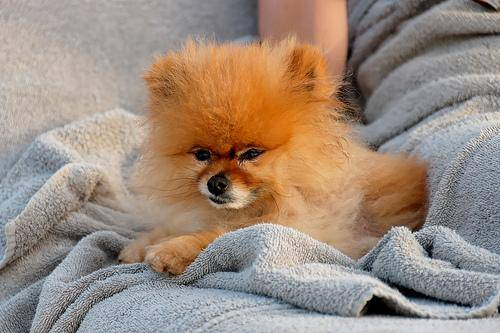

In [12]:
# One more check

Image(filenames[8000])

In [13]:
print(labels_csv.breed[8000])

pomeranian


Since we've now got our training image filepath in a list. Let's prepare our labels

In [14]:
import numpy as np
labels = labels_csv.breed.to_numpy()
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [15]:
len(labels)

10222

In [16]:
# See if number of labels matches the number of filenames

if len(labels) == len(filenames):
  print('Number of labels matches number of filenames!')
else:
  print('Number of labels does not match number of filenames. Check data directories!')

Number of labels matches number of filenames!


In [17]:
# Find the unique label values
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [18]:
len(unique_breeds)

120

In [19]:
# Turn a single label into an array of booleans
print(labels[0])

boston_bull


In [20]:
labels[0] == unique_breeds

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [21]:
# Turn every label into a boolean array

boolean_labels = [label == unique_breeds for label in labels]

In [22]:
boolean_labels[:3]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [23]:
len(boolean_labels)

10222

In [24]:
# Example: Tunring boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there swill be a 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set

Since the dataset from Kaggle doesn't come with a validation set, we're going to create our own.

In [25]:
# Setup X and y variables
X = filenames
y = boolean_labels

In [26]:
len(filenames)

10222

We're going to start off experimenting with ~1000 images and increase as needed

In [27]:
# Set number of images to use for experimenting

NUM_IMAGES = 1000 #@param{type:'slider', min:1000, max:10000, step:1000}

In [28]:
# Let's split our data into train and validation sets

from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size = 0.2,
                                                  random_state = 42)
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

### Preprocessing Images (Turning images into tensors)

To preprocess our images into Tensors, we're going to write a function which does a few things:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image` (a jpg) into Tensors.
4. Resize the `image` to be a safe of (224, 224)
5. Return the modified `image`.

Before we do, let's see what importing an image looks like.


In [29]:
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [30]:
image

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  53],
        [ 97,  88,  49],
        [120, 111,  72]]

In [31]:
image.max(), image.min()

(255, 0)

In [32]:
# Turn this into a tensor
tf.constant(image)

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

Now that we've seen what an image looks like as a tensor, let's make a function to preprocess them

1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`.
3. Turn our `image` (a jpg) into Tensors.
4. Normalize our `image` - convert color channel values from 0-255 to 0-1
5. Resize the `image` to be a safe of (224, 224)
6. Return the modified `image`.

In [33]:
# Define image size

IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path, img_size = IMG_SIZE):
  """
  Takes am image filepath and turns the image to a Tensor
  """
  # Read an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour chanels (R, G, B)
  image = tf.image.decode_jpeg(image, channels=3)
  # Conver the colour channel values from 0-255 to 0-1 (Normalize)
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value 224, 224
  image = tf.image.resize(image, size = [img_size, img_size])

  return image

## Turning our data into batches.

Why turn our data into batches?

Let's say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So that's why we do about 32 (this is the batch size) images at a time (you can manually adjust the batch size if need be)

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this: (`image`, `label`)

In [34]:
# Create a simple function to return tuple (images, label)

In [35]:
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label)
  """
  image = process_image(image_path)
  return image, label

In [36]:
get_image_label(X[42], y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a away to turn our data into tuples of Tensors in the form: `(image, label)`, let's make a function to turn all of our data (`X` and `y`) into batches

In [37]:
# Define batch size,32 is a good start
BATCH_SIZE = 32
# Create a function to turn data into batches
def create_data_batches(X, y = None, batch_size = BATCH_SIZE, valid_data = False, test_data = False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles and data if it's training data but does NOT shuffle if it's validation data.
  Also accepts test data as input (no labels)
  """

  # if the data is a test dataset, we probably don't have labels
  if test_data:
    print('Creating test data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

    # if the data is a valid data set, we don't need to shuffle it
  elif valid_data:
    print('Creating validation data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), #filepaths
                                               tf.constant(y))) #labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print('Creating training data batches...')
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), #filepaths
                                                tf.constant(y))) #labels 
    data = data.shuffle(buffer_size = len(X))
    data = data.map(get_image_label)
    data_batch = data.batch(BATCH_SIZE) 
    return data_batch                                                                            

In [38]:
train_data = create_data_batches(X_train, y_train)

Creating training data batches...


In [39]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [40]:
# check out the diff attributes of data batches
train_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

In [41]:
val_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

## Visualizing Data Batches

Our data is now in batches, however, these can be a little hard to understand/comprehend. Let's visualize them

In [42]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a databatch

def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a batch
  """

  # Setup the figure
  plt.figure(figsize = (10, 10))
  # Loop through 25
  for i in range(25):
    # Create subplots (5 x 5)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis('off')

In [43]:
train_data.as_numpy_iterator()

In [44]:
train_images, train_labels = next(train_data.as_numpy_iterator())
# unbatched the data using as_numpy_iterator

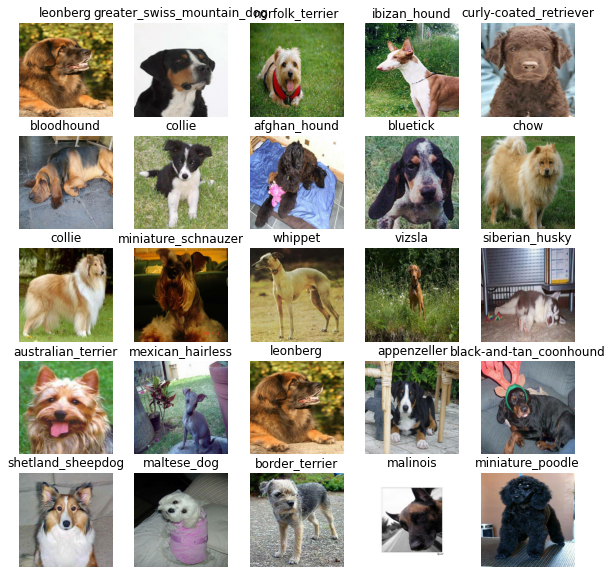

In [45]:
# Now let's visualize the data in a training batch
show_25_images(train_images, train_labels)

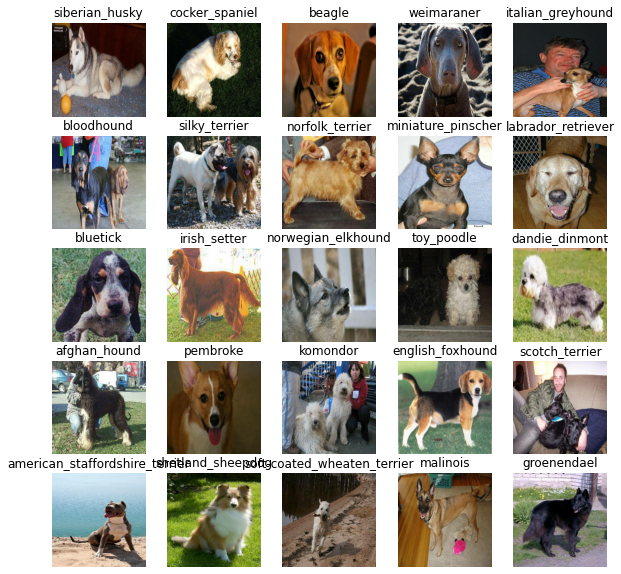

In [46]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

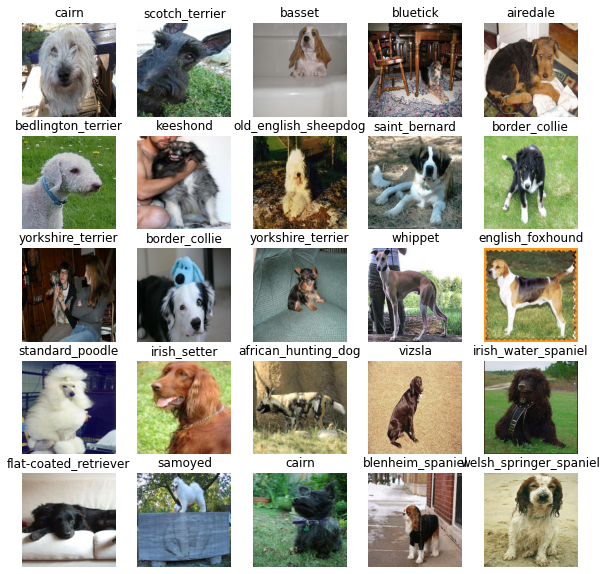

In [47]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## Building a model

Before we build a model, there are a few things we need to define:
* The input shape (our shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use from TensorFlow Hub - https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4.

In [48]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from Tensorflow Hub
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4'


Now we've got our inputs, outputs, and model ready to go. Let's put them together into a Keras deep learning model!

Knowing this, let's create a function which:
* Takes the input shape, output shape, and the model we've chosen as parameters.
* Defines the layers in a Keras model in sequential fashion. (Do this first, then this, then that)
* Compiles the model (says how it should be evaluated and improved).
* Builds the model (tells the model the input shape it'll be getting)
* Returns the model.

All of these steps can be found here: https://www.tensorflow.org/guide/keras/overview

In [49]:
# Create a function which builds a Keras model

def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print('Building model with:', model_url)
  # Setup the model layers:
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), # layer 1 (input layer)
      tf.keras.layers.Dense(units=output_shape,
                           activation='softmax') # layer 2 (output layer) 
  ])

  # Compile the model
  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics=['accuracy']
  )

  # Build the model
  model.build(input_shape)

  return model

In [50]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


## Creating callbacks

Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress, or stop training early if it stops improving.

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training for too long.

### TensorBoard Callbacks

To setup a TensorBoard callbacks, we need to do 3 things:
1. Load the TensorBoard notebook extension
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit` function.
3. Visualize our models training logs with the `%tensorboard` magic function. We'll do this after model training.

In [51]:
# Load TensorFlow notebook extension
%load_ext tensorboard

In [52]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # create a log directory for storing TensorBoard logs
  logdir = os.path.join('drive/My Drive/Dog Vision/logs', 
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime('%Y%m%d-%H%M%S'))
  return tf.keras.callbacks.TensorBoard(logdir)


### Early Stopping Callback

Early stopping helps stop our model from ovegrfitting by stopping training if a certain evaluation metric stops improving.

In [53]:
# Create early stopping callback

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                  patience = 3)

## Training a model (on subset of data)

Our first model is only going to train on 100 images, to make sure everything is working.


In [54]:
NUM_EPOCHS = 100 #@param {type:'slider', min:10, max:100, step:10}

In [55]:
# Check to make sure we're still running on a GPU

print('GPU', 'available' if tf.config.list_physical_devices('GPU') else 'not available')

GPU available


Let's create a function which trains a model.

* Create a model using `create_model()`
* Setup a TensorBoard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model passing it the training data,  validation data, number of epochs to train for (`NUM_EPOCHS`) and the callbacks we'd like to use.
* Return the model

In [56]:
# Build a function to train and return a trained model.

def train_model():
  """
  Trains a given model and returns the trained version
  """

  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data, # databatch
            epochs=NUM_EPOCHS, # how many times our model is allowed to look at training data before it stops
            validation_data=val_data, #databatch
            validation_freq=1,
            callbacks = [tensorboard, early_stopping]) #how often we want to test the patterns that the model has found

  return model


In [57]:
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
 1/25 [>.............................] - ETA: 0s - loss: 5.8516 - accuracy: 0.0000e+00WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.


Instructions for updating:
use `tf.profiler.experimental.stop` instead.


25/25 [==============================] - 343s 14s/step - loss: 4.6583 - accuracy: 0.0862 - val_loss: 3.3985 - val_accuracy: 0.2900
Epoch 2/100
25/25 [==============================] - 5s 184ms/step - loss: 1.6716 - accuracy: 0.6837 - val_loss: 2.0878 - val_accuracy: 0.5250
Epoch 3/100
25/25 [==============================] - 5s 183ms/step - loss: 0.5895 - accuracy: 0.9337 - val_loss: 1.6329 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 5s 186ms/step - loss: 0.2608 - accuracy: 0.9812 - val_loss: 1.4231 - val_accuracy: 0.6300
Epoch 5/100
25/25 [==============================] - 5s 185ms/step - loss: 0.1508 - accuracy: 0.9962 - val_loss: 1.3396 - val_accuracy: 0.6650
Epoch 6/100
25/25 [==============================] - 5s 186ms/step - loss: 0.1034 - accuracy: 0.9987 - val_loss: 1.3055 - val_accuracy: 0.6650
Epoch 7/100
25/25 [==============================] - 5s 181ms/step - loss: 0.0771 - accuracy: 1.0000 - val_loss: 1.2762 - val_accuracy: 0.6700
Epoch 8/100

**Question:** It looks like our model is overfitting because it's performing far better on the training dataset than the validation dataset. What are some ways to prevent model overfitting in deep learning neural networks?

**Note:** Overfitting to begin with is a good thing - it means our model is learning.

### Checking the TensorBoard logs
The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and visualize its contents.

In [58]:
%tensorboard --logdir drive/My\ Drive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model

In [59]:
# Make predictions on the validation data (not used to train on)

predictions = model.predict(val_data, verbose = 1)
predictions

7/7 [==============================] - 1s 120ms/step


array([[2.5162182e-03, 1.3433280e-04, 3.8930101e-03, ..., 1.4971181e-04,
        5.0804283e-05, 2.1182639e-03],
       [8.6662103e-04, 5.4435141e-04, 2.9029653e-03, ..., 6.0637610e-04,
        1.6714456e-03, 3.5405043e-04],
       [2.7196087e-05, 1.1348271e-04, 5.5751047e-05, ..., 1.1652406e-04,
        3.1436632e-06, 8.0546844e-05],
       ...,
       [4.8417508e-07, 7.4962945e-06, 1.7352253e-05, ..., 2.7440094e-06,
        9.2320734e-06, 3.8315946e-05],
       [7.5553935e-03, 9.1949344e-04, 2.5933771e-04, ..., 1.7612215e-04,
        6.5172098e-05, 2.2907865e-03],
       [7.8982346e-05, 3.2704927e-05, 1.6333793e-03, ..., 1.9453842e-03,
        3.5851885e-04, 8.2159517e-05]], dtype=float32)

In [60]:
predictions.shape

(200, 120)

[2.51621823e-03 1.34332804e-04 3.89301009e-03 6.59516663e-05
 1.08573542e-04 1.36213748e-05 2.69785821e-02 2.53636652e-04
 1.48930936e-04 7.41191441e-04 4.03923368e-05 9.39985111e-05
 1.54686611e-04 8.99740699e-05 7.74557993e-04 9.77114425e-04
 7.07085928e-05 3.43004197e-01 2.22312483e-05 1.11548303e-04
 6.21681043e-04 1.61528849e-04 5.10932114e-06 5.64130372e-04
 3.43005777e-05 2.49237579e-04 1.38114855e-01 1.69871841e-04
 1.40494155e-03 4.47727107e-05 9.89460968e-05 2.21585185e-04
 5.60526096e-04 1.31881197e-05 6.06628601e-05 4.10299078e-02
 3.80647725e-05 2.40910915e-04 1.19183824e-04 4.92881401e-04
 2.06200421e-04 6.51401479e-06 1.50598120e-04 1.45611906e-04
 1.23393793e-05 1.17229516e-04 3.99582823e-05 2.31856375e-05
 2.59095890e-04 4.04101185e-04 7.46988298e-05 1.22138472e-05
 3.85513704e-04 1.73260360e-05 1.15486189e-04 5.91721937e-06
 1.51468033e-04 9.44433443e-04 4.65790101e-04 9.23554078e-02
 5.13280509e-04 1.68331990e-05 3.78627470e-03 1.30830804e-05
 2.27223820e-04 1.379076

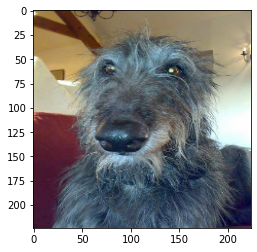

In [61]:
# First predictions

index = 25
print(predictions[0])
print(f'Max value (probability of prediction): {np.max(predictions[index])}')
print(f'Sum: {np.sum(predictions[index])}')
print(f'Max index: {np.argmax(predictions[index])}')
print(f'Predicted label: {unique_breeds[np.argmax(predictions[index])]}')
plt.imshow(val_images[index])

Having the above functionality is great but we want to be able to do it at scale.

And it would be even better if we could see the image the prediction is being made on.

**Note:** Prediction probabilities are also known as confidence levels.

In [62]:
# Turn prediction probabilities into their respective labels

def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

In [63]:
# Get a predicted label based on an array of prediction probabilities

pred_label = get_pred_label([predictions[9]])
pred_label

'collie'

Now since our validation data is still in a batch dataset, we'll have to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels)

In [64]:
# Create a function to unbatch a batch dataset

def unbatchify(batch_data):
  """
  Takes a batched dataset of image, label Tensors and returns separate arrays of images and labels.
  """
  images = []
  labels = []
  for image, label in batch_data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

In [65]:
# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've get ways to get:
* Prediction labels
* Validation labels
* Validation images

Let's make some function to make these all a bit more visualize

We'll create a function which:
* Takes an array of prediction probabilities, an array of truth labels and an array of images and integers.
* Convert the prediction probabilities to a predicted label
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot.

In [66]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth, and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image and remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong

  if pred_label == true_label:
    color = 'green'
  else:
    color = 'red'


  # Change plot title to be predicted, probabilitiy of prediction and truth label
  plt.title('Predicted:{} \n Probability:{:2.0f}% \n True:{}'.format(pred_label,
                                    np.max(pred_prob)* 100,
                                    true_label),
            color = color)

  

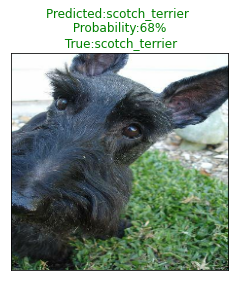

In [67]:
plot_pred(predictions,
          val_labels,
          val_images)

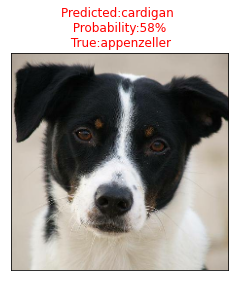

In [68]:
for n in range(len(predictions)):
  plot_pred(predictions, val_labels, val_images, n=n)

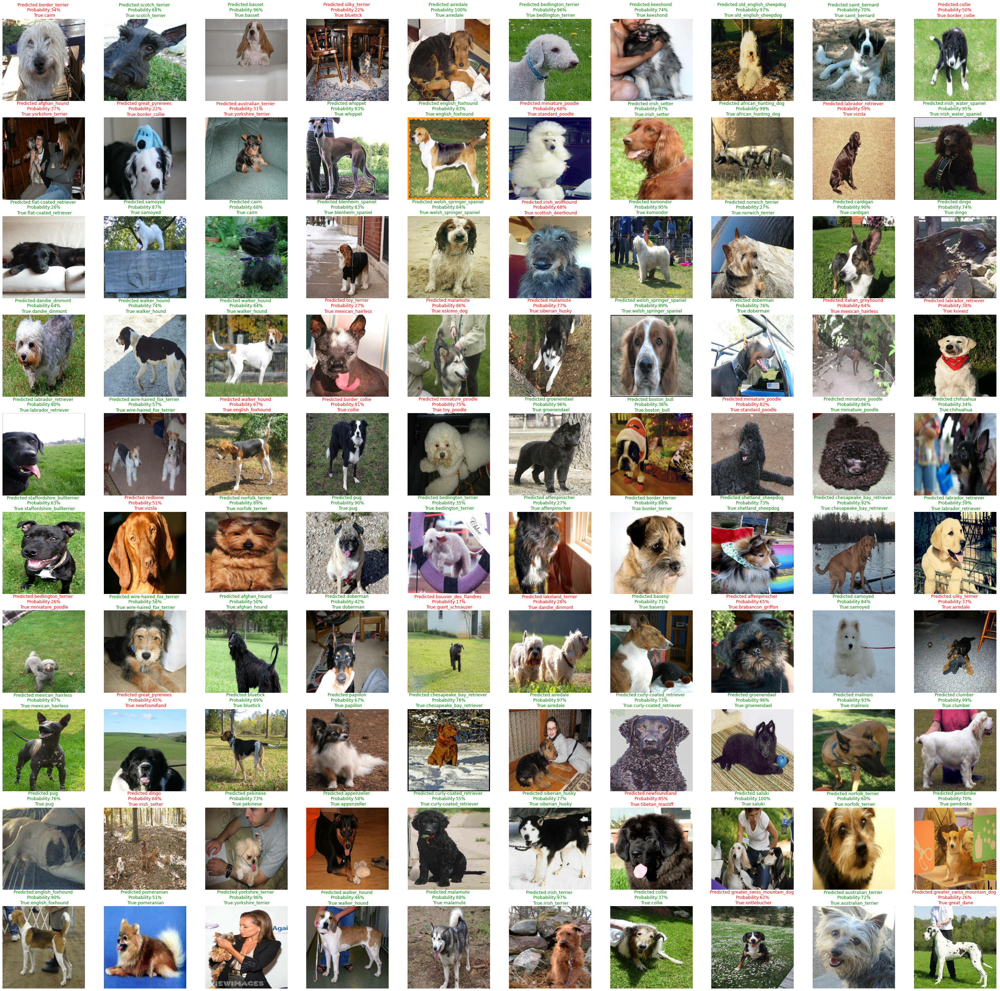

In [69]:
plt.figure(figsize = (50, 50))
  # Loop through 25
for i in range(100):
  # Create subplots (5 x 5)
  ax = plt.subplot(10, 10, i+1)
  # Display an image
  plot_pred(predictions, val_labels, val_images, n=i)
  plt.axis('off')

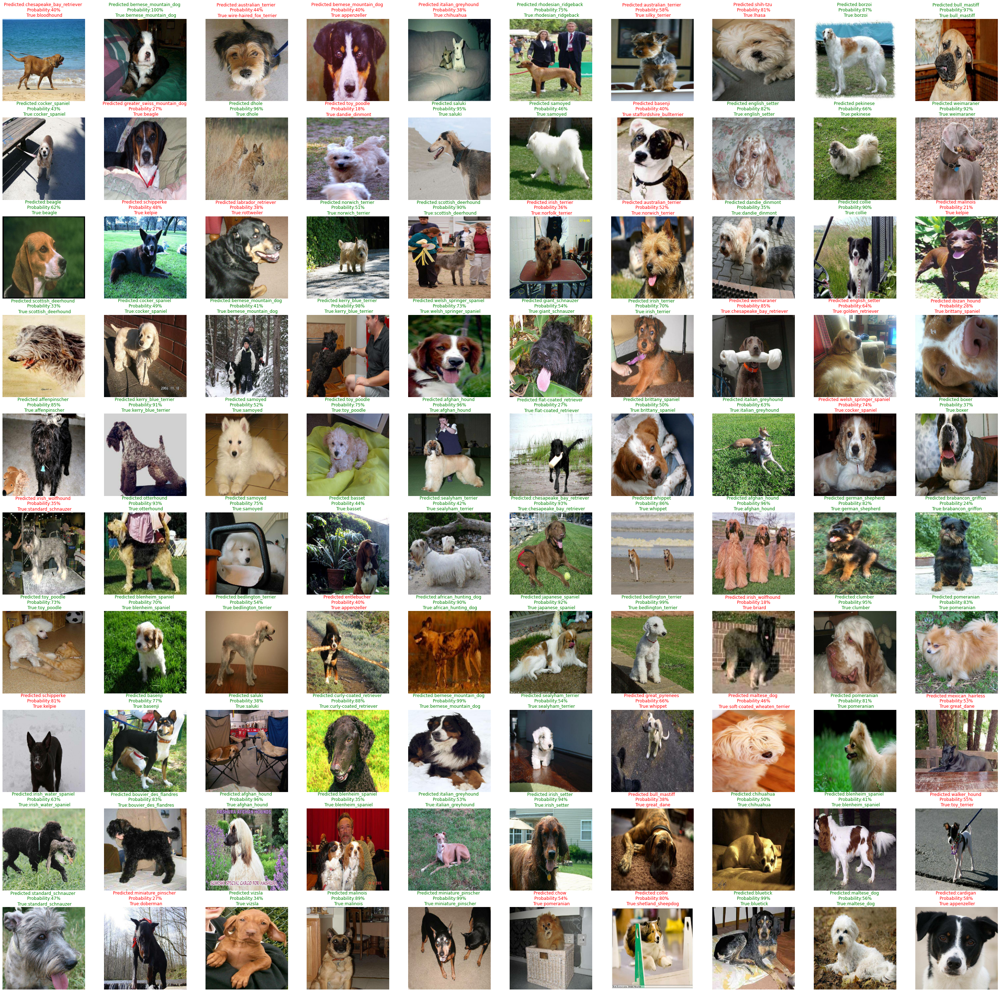

In [70]:
plt.figure(figsize = (50, 50))
  # Loop through 25
for i in range(100,200):
  # Create subplots (5 x 5)
  ax = plt.subplot(10, 10, i-99)
  # Display an image
  plot_pred(predictions, val_labels, val_images, n=i)
  plt.axis('off')

Now we've got one function to visualize our model's top prediction, let's make another to view our models top 10 predictions:

This function will:
* Take an input of prediction probabilities array and a ground truth array and an integer
* Find the prediction using `get_pred_label()`
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels

* Plot the top 10 prediction probability values and labels, coloring gthe true label green

In [71]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidece values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color = 'grey')
  plt.xticks(np.arange(len(top_10_pred_labels)),
                       labels=top_10_pred_labels,
                       rotation = 'vertical')
  
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color('green')
  else:
    pass

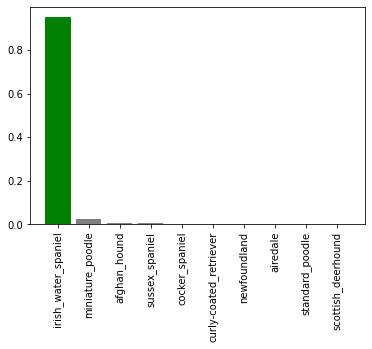

In [72]:
plot_pred_conf(predictions, val_labels, n=19)

Now we've got some function to help us visualize our predictions and evaluate our model, let's check out a few.

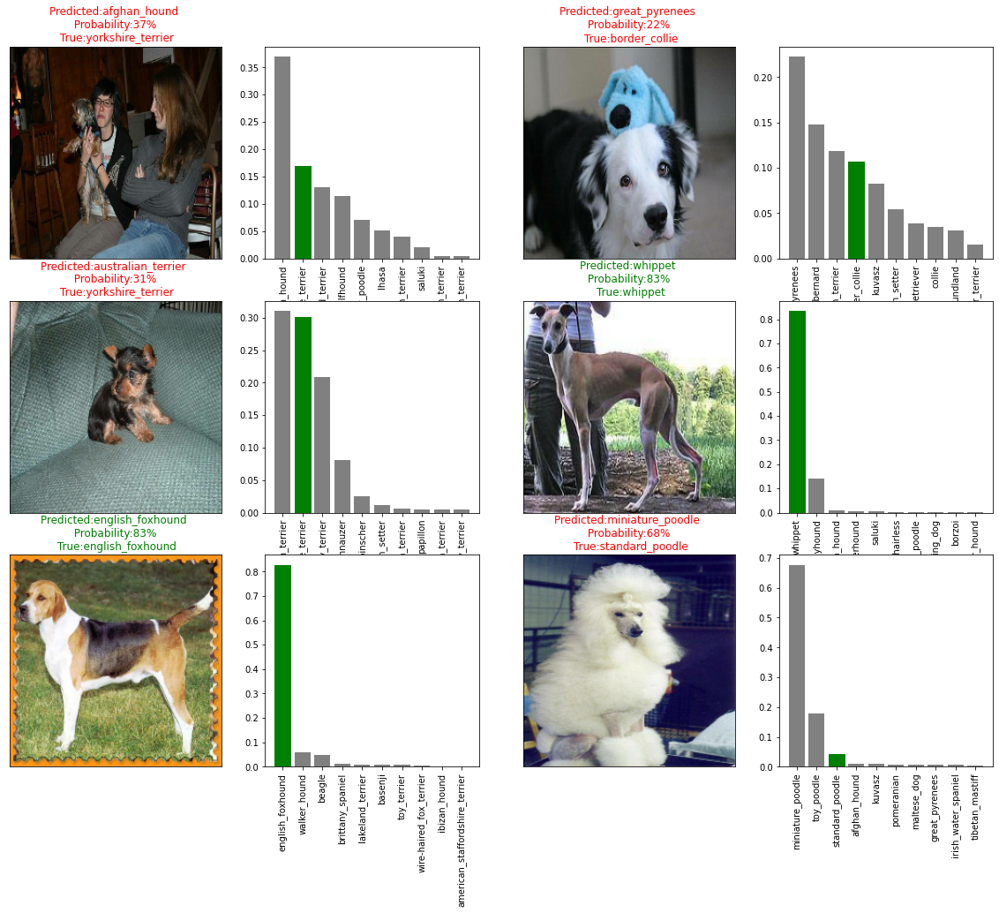

In [73]:
# Let's check out a few predictions and their different value

i_multiplier = 10
num_rows = 3
num_cols = 2
num_images = num_rows * num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(predictions, val_labels, val_images, n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(predictions, val_labels, n=i+i_multiplier)
plt.show()

# Saving and reloading a trained model

In [74]:
# Create a function to save a model

def save_model(model, suffix = None):
  """
  Saves  given model in a model directory and appends a suffix (string)
  """

  # Create a model directory pathname with current time
  modeldir = os.path.join('drive/My Drive/Dog Vision/models',
                          datetime.datetime.now().strftime('%Y%m%d-%H%M%s'))
  model_path = modeldir + '-' + suffix + '.h5' # save format of model
  print(f'Saving model to: {model_path}...')
  model.save(model_path)
  return model_path

In [75]:
# Creata a function to load a trained model
def load_model(model_path):
  """
  Loads  saved model from specified path.
  """

  print(f'Loading saved model from:{model_path}')
  model = tf.keras.models.load_model(model_path,
                                     custom_objects = {'KerasLayer':hub.KerasLayer})
  return model

In [76]:
# save our model tained on 1000 images

save_model(model, suffix='1000-images-mobilenetv2-adam')

Saving model to: drive/My Drive/Dog Vision/models/20200915-19041600196644-1000-images-mobilenetv2-adam.h5...


'drive/My Drive/Dog Vision/models/20200915-19041600196644-1000-images-mobilenetv2-adam.h5'

In [77]:
# Load
loaded_1000_image_model = load_model('drive/My Drive/Dog Vision/models/20200605-04201591330838-1000-images-mobilenetv2-adam.h5')

Loading saved model from:drive/My Drive/Dog Vision/models/20200605-04201591330838-1000-images-mobilenetv2-adam.h5


In [78]:
model.evaluate(val_data)

7/7 [==============================] - 1s 109ms/step - loss: 1.1903 - accuracy: 0.7000


[1.1902954578399658, 0.699999988079071]

In [79]:
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 1s 119ms/step - loss: 1.2474 - accuracy: 0.6750


[1.2473742961883545, 0.675000011920929]

## Training a big dog model (on full data)

In [80]:
# Create a data batch with full data set

full_data = create_data_batches(X,y)

Creating training data batches...


In [81]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [82]:
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [83]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all data, so we can't monitor validation accuracy
full_model_earlystopping = tf.keras.callbacks.EarlyStopping(monitor='accuracy',
                                                            patience = 3)

In [84]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_earlystopping])

Epoch 1/100
320/320 [==============================] - 3908s 12s/step - loss: 1.3478 - accuracy: 0.6695
Epoch 2/100
320/320 [==============================] - 46s 144ms/step - loss: 0.4065 - accuracy: 0.8789
Epoch 3/100
320/320 [==============================] - 49s 152ms/step - loss: 0.2426 - accuracy: 0.9349
Epoch 4/100
320/320 [==============================] - 47s 148ms/step - loss: 0.1563 - accuracy: 0.9634
Epoch 5/100
320/320 [==============================] - 48s 149ms/step - loss: 0.1064 - accuracy: 0.9777
Epoch 6/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0774 - accuracy: 0.9874
Epoch 7/100
320/320 [==============================] - 48s 151ms/step - loss: 0.0591 - accuracy: 0.9911
Epoch 8/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0454 - accuracy: 0.9946
Epoch 9/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0384 - accuracy: 0.9956
Epoch 10/100
320/320 [==============================] - 48s 151m

In [85]:
save_model(full_model,
           suffix = 'full-imageset-mobilenetv2-Adam')

Saving model to: drive/My Drive/Dog Vision/models/20200915-20221600201364-full-imageset-mobilenetv2-Adam.h5...


'drive/My Drive/Dog Vision/models/20200915-20221600201364-full-imageset-mobilenetv2-Adam.h5'

In [86]:
loaded_full_model = load_model('drive/My Drive/Dog Vision/models/20200610-07291591774143-full-imageset-mobilenetv2-Adam.h5')

Loading saved model from:drive/My Drive/Dog Vision/models/20200610-07291591774143-full-imageset-mobilenetv2-Adam.h5


## Making predications on the test dataset

Since our model has been trained on images in a form of Tensor batches, to make preedictions on the test data, we'll have to get it into the same format.

Luckily, we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames
* Convert the filenames into test data batches using `create_data_batches` and setting `test_data` parameter to `True` (since the test data doesn't have labels)
* Make a prediction array by passing the test batches to the `predict()` method on our model


In [87]:
# Load test image filenames
test_path = 'drive/My Drive/Dog Vision/test/'
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/My Drive/Dog Vision/test/e806fbb5ca4dd3a094f7819bd810cc65.jpg',
 'drive/My Drive/Dog Vision/test/ea057ca7f831d161d456091bf293e4b1.jpg',
 'drive/My Drive/Dog Vision/test/ed1d8dfbebbb70b252cd71e165ea3d76.jpg',
 'drive/My Drive/Dog Vision/test/eeb73a13b70170c416aab67eac15fdfb.jpg',
 'drive/My Drive/Dog Vision/test/f45014f665123584d3588802ee020bce.jpg',
 'drive/My Drive/Dog Vision/test/eeb2c4ba7170968ce151916667c450a3.jpg',
 'drive/My Drive/Dog Vision/test/f24c3d9735880ef6ea736dc549419771.jpg',
 'drive/My Drive/Dog Vision/test/ef59760870674327ca5d004bae427422.jpg',
 'drive/My Drive/Dog Vision/test/ed71e43cf7e5e8449879b5f0d38f3bd0.jpg',
 'drive/My Drive/Dog Vision/test/ed63374c99282b3081705ed84a2b93bc.jpg']

In [88]:
# Creating test data batches
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [89]:
len(test_filenames)

10357

In [90]:
test_predictions = loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 4066s 13s/step


In [92]:
np.savetxt('drive/My Drive/Dog Vision/preds_array.csv', test_predictions, delimiter = ',')

In [93]:
test_predictions = np.loadtxt('drive/My Drive/Dog Vision/preds_array.csv', delimiter = ',') 

## Preparing test dataset predictions for Kaggle

Looking at the Kaggle sample submission, we find that it wants our models prediction probability outputs in a DataFrame with an ID and a column for each different dog breed.

To get the data in this format, we'll:
* Create a pandas DF with an ID column as well as a column for each dog breed
* Add data to the ID column by extracting the test image ID's from their filepaths
* Add data (prediction probabilities) to each of the dog breed columns
* Export the dataframe as a CSV to submit it to Kaggle

In [94]:
# Create a pandas dataframe with empty columns
preds_df = pd.DataFrame(columns=['id'] + list(unique_breeds))

In [95]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids

['e806fbb5ca4dd3a094f7819bd810cc65',
 'ea057ca7f831d161d456091bf293e4b1',
 'ed1d8dfbebbb70b252cd71e165ea3d76',
 'eeb73a13b70170c416aab67eac15fdfb',
 'f45014f665123584d3588802ee020bce',
 'eeb2c4ba7170968ce151916667c450a3',
 'f24c3d9735880ef6ea736dc549419771',
 'ef59760870674327ca5d004bae427422',
 'ed71e43cf7e5e8449879b5f0d38f3bd0',
 'ed63374c99282b3081705ed84a2b93bc',
 'f16eed64196d24c423f0a68d7ebf287d',
 'ef3c75900183816388295cd9cb3a1a31',
 'e823ee1ca007c88600806925a6f2bce1',
 'f09c01de47c096fe62cd1398798c1369',
 'f27521a58ff23d0bb6390bd802b368c4',
 'ee6dad89684bbbab844ecedf70f4be2d',
 'f2bc2e10c40f94618b6d48bca353199a',
 'e917abf625ad6ba5b8a0e59bd23e8818',
 'e8fcfd7898f198f6efe756a6f93bc0fc',
 'f63632142392cb2f86a39d03a937088e',
 'fa9759d78e2c43eed645aefa3c7dcc83',
 'f8809ca08ad7e84f00061d47d2ba59c0',
 'f633268243572d8a8607d5959a0d3456',
 'f74676323a11fdfe1bd36ba5dfa0ac4e',
 'fbf4abbd32d544ff9b5df6af25eec3e3',
 'f95d1a0c5f7ef6ad663421002a0f32c9',
 'fc7870edf256498d5876033baf56fbe5',
 

In [96]:
preds_df.id = test_ids

In [97]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e806fbb5ca4dd3a094f7819bd810cc65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,ea057ca7f831d161d456091bf293e4b1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ed1d8dfbebbb70b252cd71e165ea3d76,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,eeb73a13b70170c416aab67eac15fdfb,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,f45014f665123584d3588802ee020bce,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e806fbb5ca4dd3a094f7819bd810cc65,4.47208e-08,8.61641e-10,1.98725e-09,4.45294e-05,9.13858e-10,1.38224e-10,2.57593e-06,7.09528e-10,1.5473e-11,3.21744e-09,7.3739e-08,2.93269e-08,7.74235e-09,3.82306e-11,3.57011e-09,1.94658e-10,1.64585e-09,1.18336e-06,3.72722e-09,9.69558e-11,2.11502e-09,8.05316e-11,1.33296e-07,8.0298e-08,1.72088e-09,4.42353e-08,4.24334e-10,6.03972e-11,3.77231e-09,1.52315e-10,4.40239e-09,1.67914e-09,3.88693e-10,1.61038e-07,4.98607e-08,4.18505e-08,2.86045e-09,2.30234e-09,1.2983e-05,...,2.12845e-10,5.4952e-07,2.37649e-07,0.000618062,2.54474e-11,1.42443e-08,3.10418e-08,4.62512e-11,2.97295e-12,4.60891e-11,1.38635e-09,1.18688e-10,2.79032e-10,2.63027e-12,1.29066e-10,4.16616e-08,1.87765e-08,7.00063e-07,4.31347e-06,7.31775e-09,5.62652e-11,3.66269e-12,2.98978e-08,6.70969e-10,3.97223e-08,1.81456e-09,0.000178259,2.50953e-08,3.6349e-09,6.9592e-12,6.60855e-09,5.37457e-09,4.59893e-08,3.17901e-09,1.54952e-10,1.43164e-08,4.5185e-09,3.77679e-09,0.996475,9.54357e-07
1,ea057ca7f831d161d456091bf293e4b1,5.98931e-06,3.02433e-09,7.62049e-10,8.19775e-10,5.68193e-08,9.1579e-10,3.07702e-08,1.85762e-07,3.52246e-08,1.32291e-06,5.06053e-11,3.17598e-05,1.93224e-11,1.19167e-06,3.83874e-10,3.62355e-07,1.4292e-07,2.51532e-07,6.20892e-11,2.89951e-05,2.73848e-09,3.18562e-07,4.51093e-08,8.88933e-10,1.0899e-08,2.38941e-08,1.07909e-07,3.7057e-09,6.3244e-11,1.86824e-07,5.26419e-09,7.92005e-09,2.20484e-06,1.22411e-08,9.94141e-11,1.74473e-08,1.52016e-09,6.84525e-11,2.11806e-11,...,9.68072e-10,1.46125e-08,9.42112e-07,7.80012e-08,1.71243e-06,1.75928e-07,2.26867e-10,3.36868e-09,2.59282e-07,2.8196e-09,9.68074e-11,4.52373e-11,1.03533e-07,6.86183e-10,7.57484e-10,6.48743e-09,1.97854e-09,1.33587e-09,2.14275e-08,2.37764e-10,0.956152,5.33602e-05,5.35194e-07,5.82507e-08,6.41139e-07,5.74659e-10,1.98536e-08,4.56393e-10,5.74858e-10,0.00591136,6.07709e-07,1.6168e-07,1.23183e-09,6.95254e-07,7.94091e-10,2.54029e-08,3.81796e-06,3.80894e-10,1.69734e-07,3.28376e-05
2,ed1d8dfbebbb70b252cd71e165ea3d76,2.342e-10,7.55228e-11,8.75833e-10,4.17681e-13,8.81926e-11,7.57342e-10,1.43113e-05,1.11036e-10,6.93557e-13,1.90241e-12,2.2658e-12,1.94718e-09,2.40743e-09,5.31542e-11,2.15527e-09,4.76725e-10,8.25602e-05,3.5744e-10,8.63823e-12,1.74831e-10,2.45865e-09,2.00123e-13,1.07399e-08,3.01865e-13,6.78581e-11,4.73433e-13,1.82396e-11,4.96979e-09,5.81494e-11,6.33631e-08,3.90315e-08,1.00773e-11,3.66732e-07,3.08561e-09,3.38533e-11,2.09588e-08,1.0071e-05,6.69559e-11,2.38714e-11,...,3.54565e-06,2.15764e-09,2.76875e-11,1.60027e-09,4.10725e-08,4.54168e-10,1.32729e-06,2.32447e-07,3.06595e-10,1.88966e-08,5.40597e-10,1.03798e-08,9.34626e-13,1.34224e-11,3.45857e-08,0.999879,7.24221e-08,5.41791e-09,1.21482e-11,3.78478e-10,3.7429e-12,2.88437e-07,7.33491e-11,2.33113e-11,1.10122e-07,1.6027e-11,3.72423e-10,2.50449e-12,4.52357e-08,1.57391e-10,7.13473e-12,2.95294e-11,6.07881e-11,1.16137e-09,9.39026e-12,7.72977e-15,1.92724e-1

In [99]:
preds_df.to_csv('drive/My Drive/Dog Vision/full_model_predictions_submission_1_mobilenetV2.csv',
                index=False)